In [75]:
import os
from IPython.display import display
import pandas as pd
from preprocessing import load_data
import re
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from preprocessing import load_data
from ydata_profiling import ProfileReport

In [76]:
# df = load_data(file_path='../data/dataset.csv')
PATH = os.getcwd()
df = pd.read_csv(os.path.join(PATH, "data/music_data.csv"))
df.drop(["music_id", "id_artists"], axis=1, inplace=True)
df.head()

,user_id,age,education,gender,name,country,music,artist_name,featured_artists,genre,...,liveness,valence,tempo,time_signature,track_genre,release_date,explicit,duration,followers,ratings
0,83811,16,Undergraduate,F,Danielle,Urban,Bank Account,21 Savage,"Birdy, Zoé",Dark Trap,...,0.026536,0.198838,147.482666,5,Unknown,2017-09-23,True,3.67,440898,1.979877
1,83811,16,Undergraduate,F,Danielle,Urban,Mo Money Mo Problems (feat. Mase & Puff Daddy)...,The Notorious B.I.G.,LUDMILLA,Underground Rap,...,0.203000,0.904000,104.536000,4,hardcore,1997-03-04,False,4.29,849749,4.446776
2,83811,16,Undergraduate,F,Danielle,Urban,Little Talks,Of Monsters and Men,"Ninho, Snoop Dogg, Russ, Paramore",Unknown,...,0.146000,0.417000,102.961000,4,folk,2012-01-01,True,4.44,733052,4.193334
3,13397,17,Middle School,M,Angel,Non-Urban,Wherever I Go,OneRepublic,"Keith Urban, DJ Khaled, NIKI, MF DOOM",Unknown,...,0.270000,0.349000,99.961000,4,piano,2016-12-02,True,2.83,766179,3.311571
4,13397,17,Middle School,M,Angel,Non-Urban,Hands To Myself,Selena Gomez,"SAINt JHN, David Bisbal, will.i.am",Unknown,...,0.289388,0.079792,84.918633,3,Unknown,2015-10-09,True,3.34,399591,1.000000


In [77]:
print(df.shape)  # prints the dimensions of the DataFrame

(35001, 31)


In [80]:
# Clean text data with consistent naming conventions
def read_data(filename: str):
    PATH = os.getcwd()

    full_path = os.path.join(PATH, filename)

    if os.path.exists(full_path):
        df = pd.read_csv(full_path)
    else:
        raise FileNotFoundError("The filepath specified was not found. Please try again.")

    return df

def clean_artist_name(name):
    return re.sub(r'[$]', 'S', name)

clean_artist_name = lambda name: re.sub(r'[$]', 'S', name)

# Apply the function to the 'artist_name' column
df['artist_name'] = df['artist_name'].apply(clean_artist_name)

In [81]:
# Define presets for data visualization
def presets():
    plt.rc('figure', autolayout = True)

    plt.rc('axes', 
        labelsize = 'large',
        labelweight = 'bold',
        titlesize = 14,
        titleweight = 'bold',
        titlepad = 10       
    )

    %config InlineBackend.figure_format = 'retina'
    pd.options.display.max_rows = 10
    sns.set_style('darkgrid')
    warnings.filterwarnings(action = 'ignore', category = UserWarning)
    return 

presets()



In [60]:
df.info(memory_usage="deep")  # prints the memory usage of the DataFrame

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35001 entries, 0 to 35000
Data columns (total 31 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   user_id             35001 non-null  int64  
 1   age                 35001 non-null  int64  
 2   education           35001 non-null  object 
 3   gender              35001 non-null  object 
 4   name                35001 non-null  object 
 5   country             35001 non-null  object 
 6   music               35001 non-null  object 
 7   artist_name         35001 non-null  object 
 8   featured_artists    15808 non-null  object 
 9   genre               35001 non-null  object 
 10  plays               35001 non-null  int64  
 11  artiste_popularity  35001 non-null  float64
 12  audio_popularity    35001 non-null  float64
 13  music_acousticness  35001 non-null  float64
 14  danceability        35001 non-null  float64
 15  energy              35001 non-null  float64
 16  key 

In [82]:
# df.shape
df.describe(include="all")  # prints the summary statistics of the DataFrame

,user_id,age,education,gender,name,country,music,artist_name,featured_artists,genre,...,liveness,valence,tempo,time_signature,track_genre,release_date,explicit,duration,followers,ratings
count,35001.000000,35001.000000,35001,35001,35001,35001,35001,35001,15808,35001,...,35001.000000,35001.000000,35001.000000,35001.000000,35001,35001,35001,35001.000000,35001.000000,35001.000000
unique,NaN,NaN,4,2,664,2,19693,8475,13703,41,...,NaN,NaN,NaN,NaN,93,2122,2,NaN,NaN,NaN
top,NaN,NaN,Graduate,F,Michael,Urban,Closer,Drake,DaBaby,Unknown,...,NaN,NaN,NaN,NaN,Unknown,2000-01-01,False,NaN,NaN,NaN
freq,NaN,NaN,10413,17891,758,18016,49,441,11,4423,...,NaN,NaN,NaN,NaN,31312,20183,17542,NaN,NaN,NaN
mean,49832.318734,35.950973,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.467704,0.503728,124.744468,3.991486,NaN,NaN,NaN,3.903261,499896.999314,2.865360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
min,4.000000,13.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.000007,0.000009,48.718000,1.000000,NaN,NaN,NaN,0.000000,1017.000000,1.000000
25%,24864.000000,18.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.198683,0.264390,89.948086,3.000000,NaN,NaN,NaN,3.320000,249746.000000,1.000000
50%,49652.000000,31.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.448406,0.507000,124.127639,4.000000,NaN,NaN,NaN,3.750000,499896.000000,3.585313
75%,74709.000000,52.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.722513,0.745113,160.115459,5.000000,NaN,NaN,NaN,4.310000,748051.000000,4.170578


In [83]:
# check for any missing values
df.isnull().any().any()

True

In [84]:
missing_values = np.where(df.isnull(), 1, 0).sum()
print(
    "\nMissing Values:\n", missing_values
)  # prints the number of missing values in each column


Missing Values:
 19193


In [85]:
# profile = ProfileReport(df, title="EDA Report", explorative=True) # generates a profile report of the DataFrame

In [86]:
# profile.to_notebook_iframe() # displays the profile report in the Jupyter notebook

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

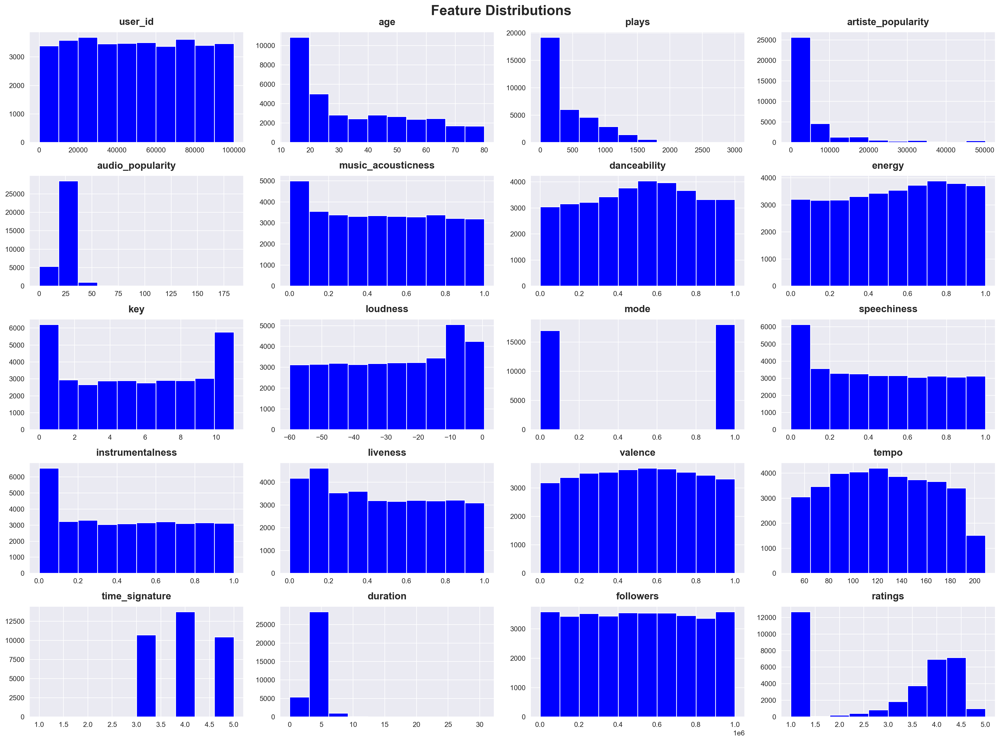

In [63]:
# Plot histograms
supt_presets = dict(fontsize=20, fontweight="bold")

df.hist(figsize=(20, 15), color="blue")
plt.suptitle("Feature Distributions", **supt_presets)
plt.show()  # plots the histograms of the DataFrame

In [64]:
df.select_dtypes(
    include=["category", "object"]
).columns.tolist()  # prints the columns with categorical data

['education',
 'gender',
 'name',
 'country',
 'music',
 'artist_name',
 'featured_artists',
 'genre',
 'track_genre',
 'release_date']

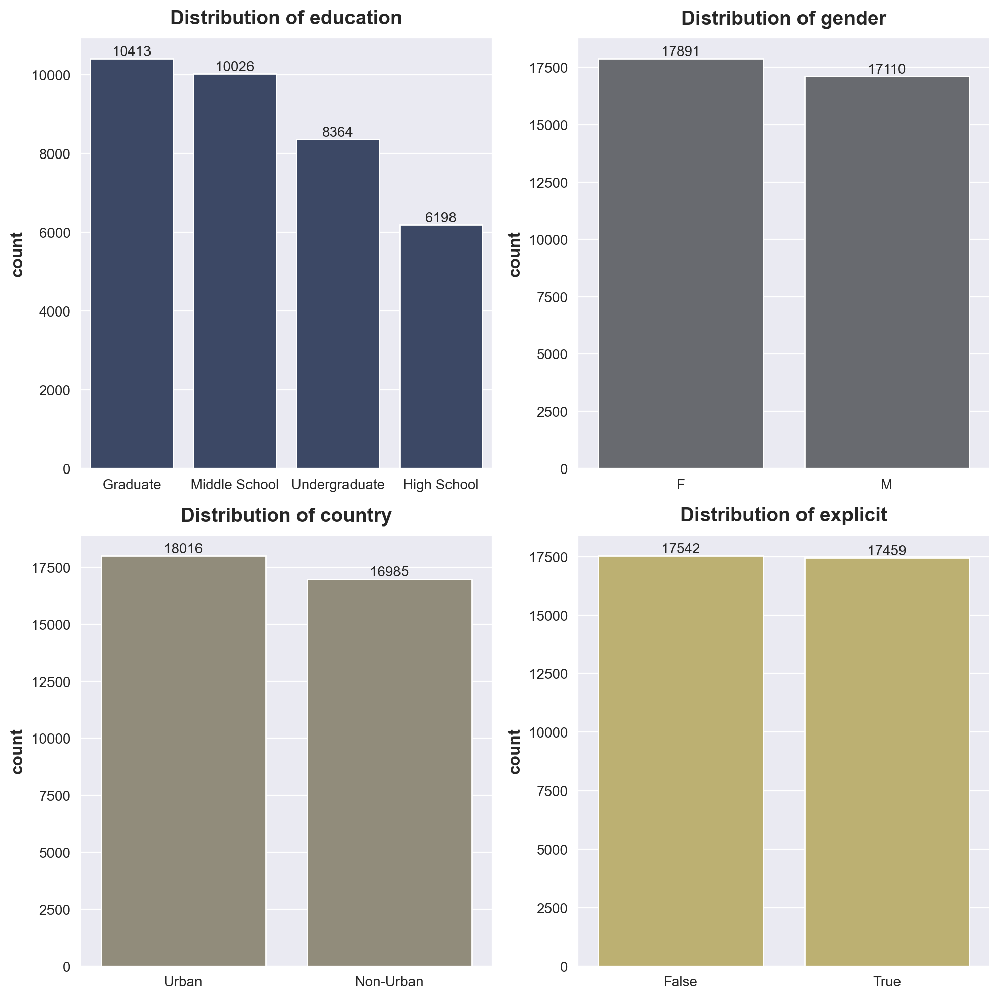

In [65]:
# distribution of categorical columns
cat_cols = ["education", "gender", "country", "explicit"]
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
cc = sns.color_palette(n_colors=len(cat_cols), palette="cividis")

for i, ax in enumerate(axes.flatten()):
    # Count the occurrences of each category
    count_data = df[cat_cols[i]].value_counts().sort_values(ascending=False)
    sns.countplot(x=cat_cols[i], data=df, order=count_data.index, ax=ax, color=cc[i])
    ax.set(xlabel="", title=f"Distribution of {cat_cols[i]}")
    ax.bar_label(ax.containers[0], fmt="%.0f")
plt.show()

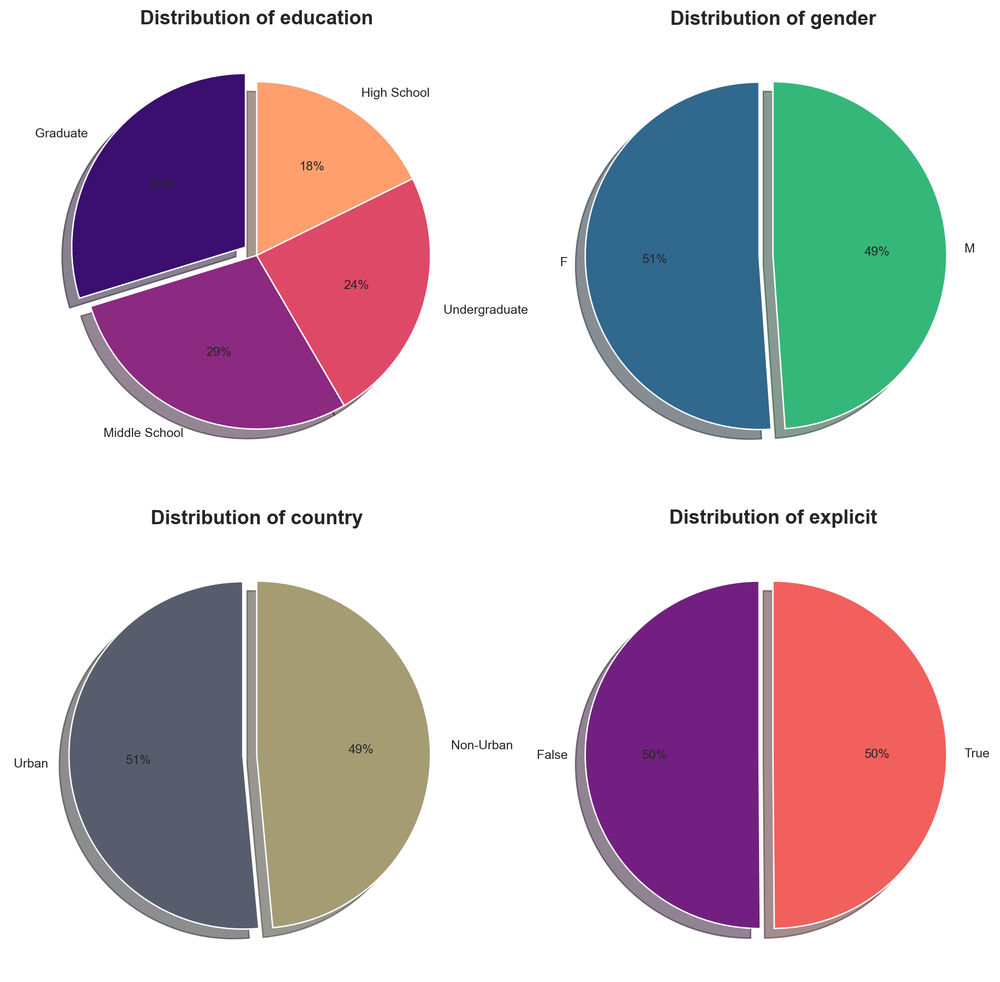

In [66]:
cat_cols = ["education", "gender", "country", "explicit"]
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
cc = ["magma", "viridis", "cividis", "magma"]

for i, ax in enumerate(axes.flatten()):
    # Count the occurrences of each category
    count_data = df[cat_cols[i]].value_counts().sort_values(ascending=False)
    # Create pie chart
    n = count_data.shape[0]
    wedges, texts, autotexts = ax.pie(
        count_data,
        labels=count_data.index,
        autopct="%.0f%%",
        colors=sns.color_palette(n_colors=n, palette=cc[i]),
        startangle=90,
        textprops={"fontsize": 9},
        explode=[0.08] + [0] * (n - 1),
        shadow=True,
    )
    ax.set(title=f"Distribution of {cat_cols[i]}")

plt.tight_layout()
plt.show()  # plots the distribution of categorical columns

In [21]:
df.groupby("artist_name")["plays"].sum().sort_values(ascending=False).head(20)

artist_name
Drake             173501
Kanye West         68502
Kendrick Lamar     60249
The Weeknd         57411
Rihanna            56747
                   ...  
Migos              36667
Lil Wayne          36378
Calvin Harris      35516
Maroon 5           35053
Post Malone        34886
Name: plays, Length: 20, dtype: int64

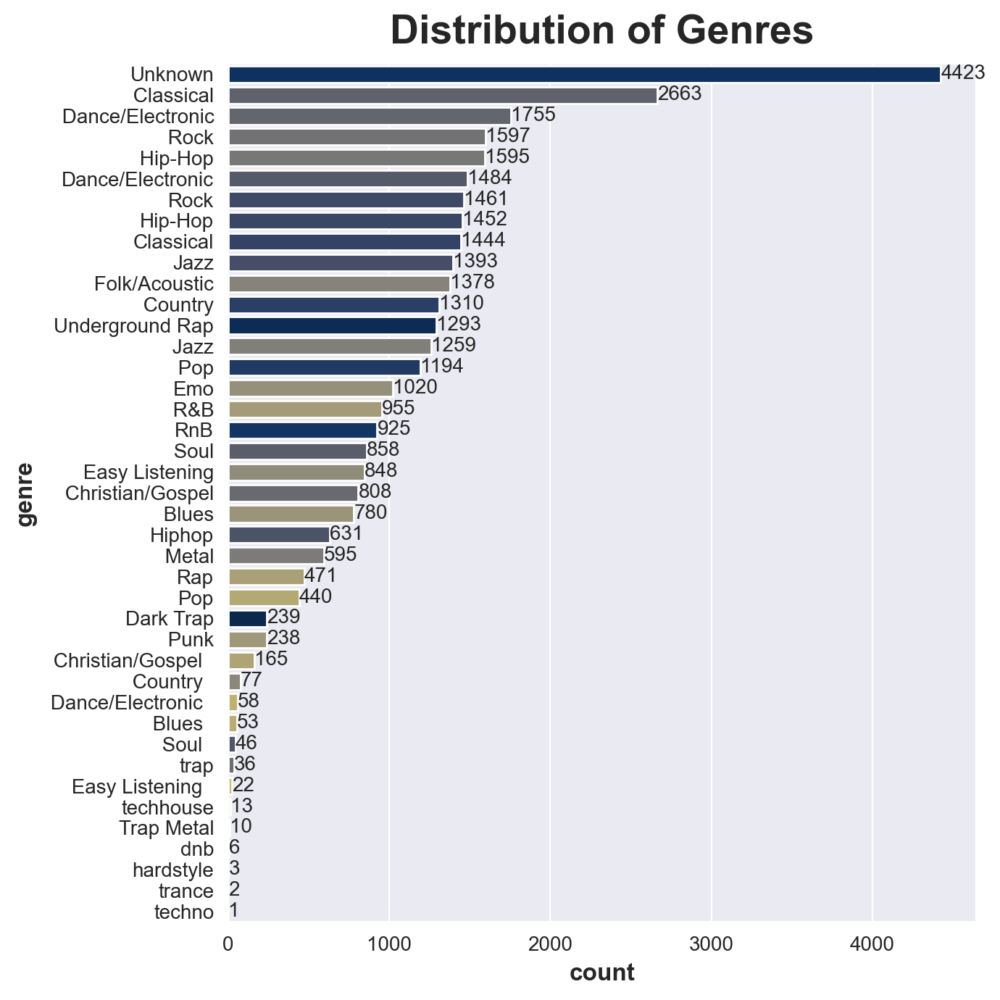

In [74]:
count_order = df["genre"].value_counts().sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(7, 7))
sns.countplot(
    df,
    y="genre",
    hue="genre",
    order=count_order.index,
    ax=ax,
    palette="cividis",
    legend=False,
)
ax.set_title("Distribution of Genres", **supt_presets)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")  # plots the distribution of genres

## Examining Popularity of Artists

---


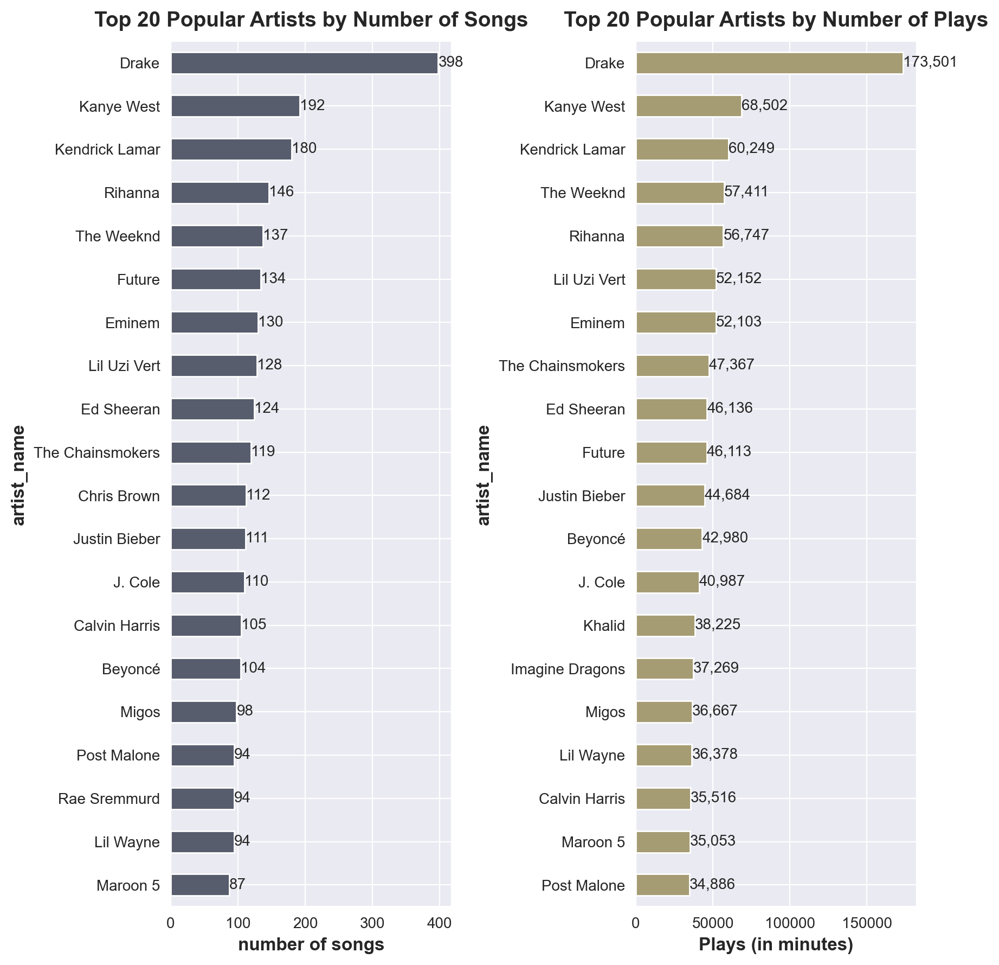

In [25]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 9))
TAIL = 20
cc_ = sns.color_palette(n_colors=2, palette="cividis")

df["artist_name"].value_counts().sort_values().tail(TAIL).plot(
    kind="barh", color=cc_[0], ax=ax1
)
ax1.set(
    title=f"Top {TAIL} Popular Artists by Number of Songs", xlabel="number of songs"
)
for container in ax1.containers:
    ax1.bar_label(container, fmt="%.0f")

df.groupby("artist_name")["plays"].sum().sort_values().tail(TAIL).plot(
    kind="barh", color=cc_[1], ax=ax2
)
ax2.set(
    title=f"Top {TAIL} Popular Artists by Number of Plays", xlabel="Plays (in minutes)"
)
for container in ax2.containers:
    ax2.bar_label(container, labels=[f"{int(v):,}" for v in container.datavalues])

plt.tight_layout()  # plots the top 20 popular artists by number of songs and plays

In [26]:
date_cols = [col for col in df.columns if "date" in col]
for col in date_cols:
    df[col] = pd.to_datetime(df[col], errors="coerce").dropna(
        axis=0
    )  # converts the columns to datetime format

In [27]:
duration_over_time = df.groupby("release_date")[["duration"]].mean()
plays_over_time = df.groupby("release_date")[["plays"]].mean()

display(duration_over_time.head(5))
display(plays_over_time.head(5))  # prints the average duration and plays over time

,duration
release_date,
1953-08-01,2.680000
1956-10-19,2.410000
1957-06-20,1.500000
1957-10-15,2.063333
1958-03-21,2.326667


,plays
release_date,
1953-08-01,225.000000
1956-10-19,356.000000
1957-06-20,1.000000
1957-10-15,353.333333
1958-03-21,868.000000


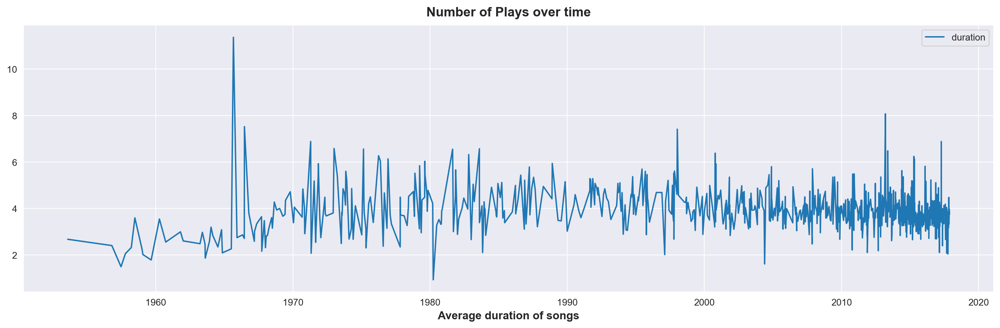

In [28]:
plt.figure(figsize=(15, 5))
sns.lineplot(duration_over_time)
plt.xlabel("Average duration of songs")
plt.title("Number of Plays over time")
plt.show()  # plots the average duration of songs over time

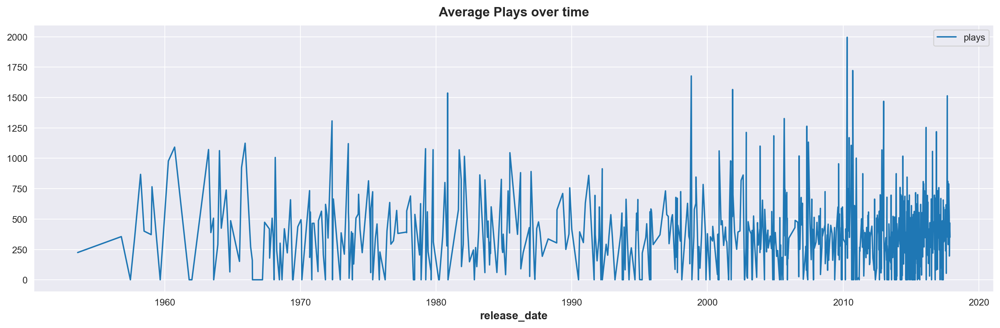

In [29]:
plt.figure(figsize=(15, 5))
sns.lineplot(plays_over_time)
plt.title("Average Plays over time")
plt.show()  # plots the average plays over time

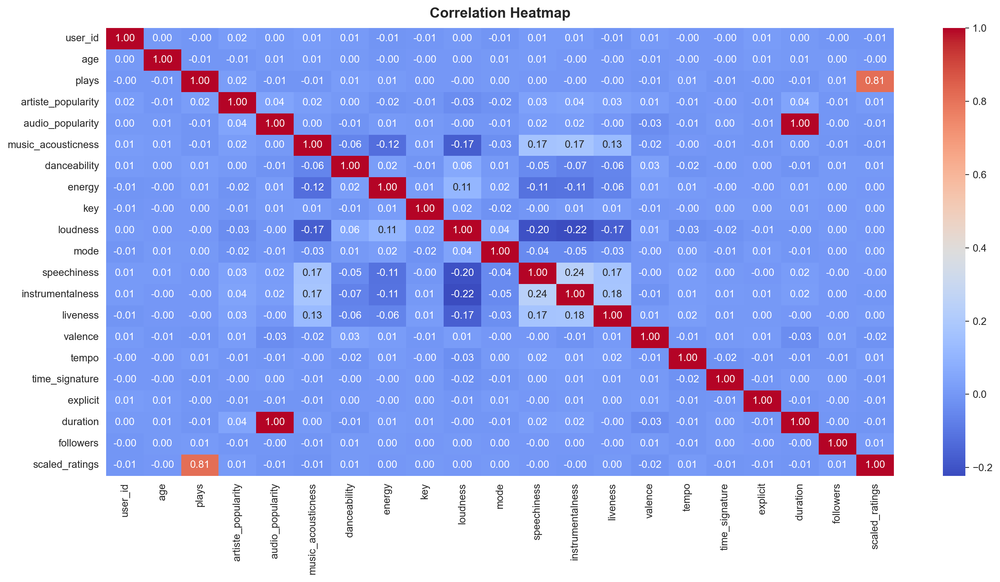

In [31]:
# Plot a correlation heatmap
plt.figure(figsize=(15, 8))
correlation_matrix = df.corr(numeric_only=True)
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Heatmap")
plt.show()  # plots the correlation heatmap

In [32]:
pivot_table = df.pivot_table(
    values="plays", index="education", columns="gender", aggfunc="mean"
)



display(
    pivot_table
)  # prints the pivot table of the average plays by education and gender

gender,F,M
education,,
Graduate,388.054310,377.227732
High School,364.016118,383.126771
Middle School,389.844391,385.083184
Undergraduate,364.090238,380.387515


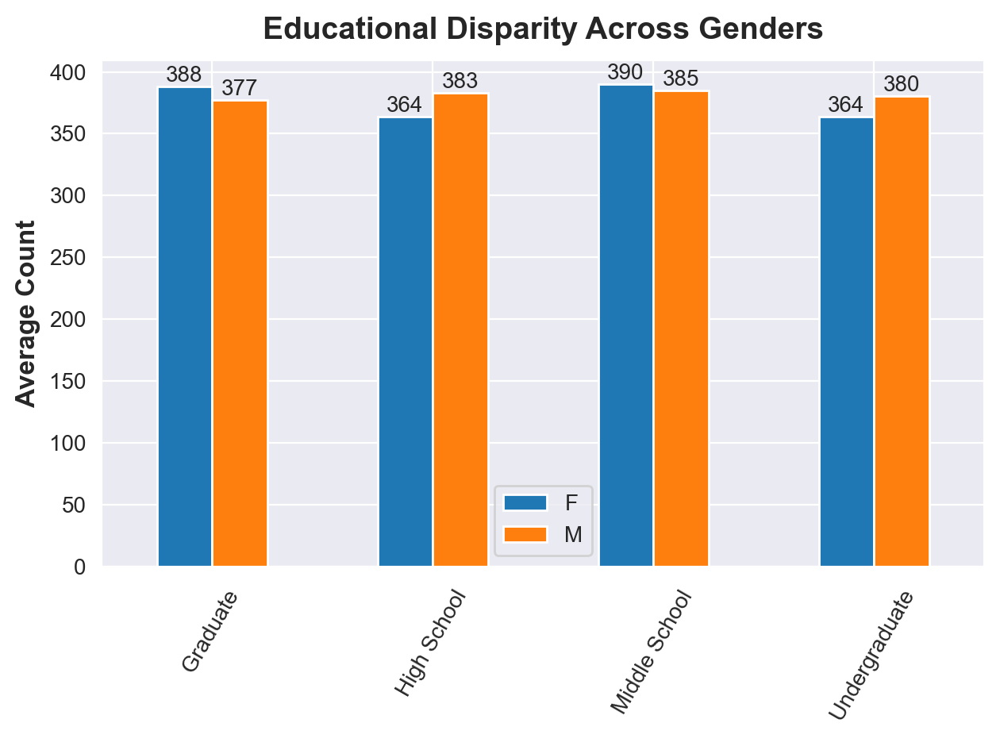

In [33]:
fig, ax = plt.subplots()
pivot_table.plot(kind="bar", ax=ax)
ax.set(xlabel="", ylabel="Average Count", title="Educational Disparity Across Genders")
ax.set_xticklabels(ax.get_xticklabels(), rotation=60)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
ax.legend() # plots the educational disparity across genders

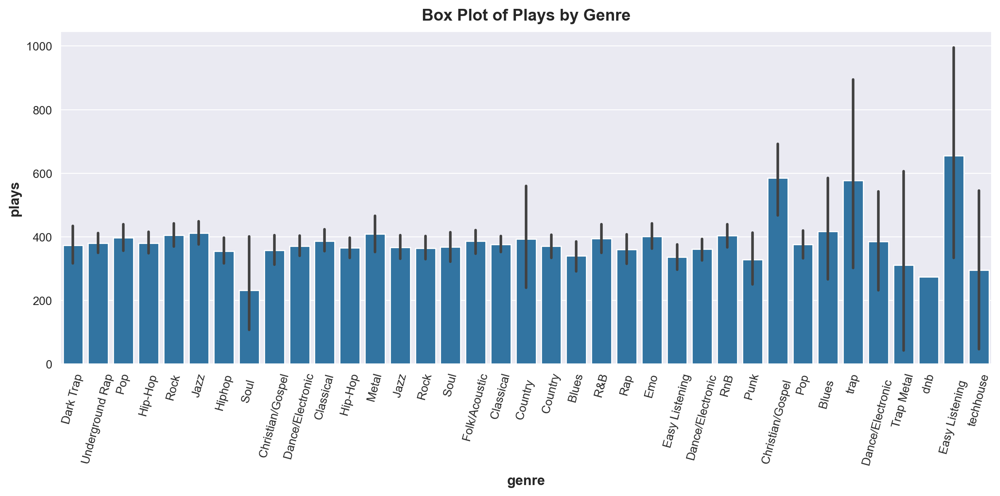

In [34]:
plt.figure(figsize=(12, 6))
sns.barplot(x="genre", y="plays", data=df)
plt.xticks(rotation=75)
plt.title("Box Plot of Plays by Genre")
plt.show() # plots the box plot of plays by genre

In [35]:
grouped_stats1 = df.groupby("education")[["plays", "duration"]].mean()
display(grouped_stats1) # prints the average plays and duration by education

,plays,duration
education,,
Graduate,382.940186,3.873673
High School,373.520958,3.881279
Middle School,387.454491,3.893635
Undergraduate,372.088150,3.876182


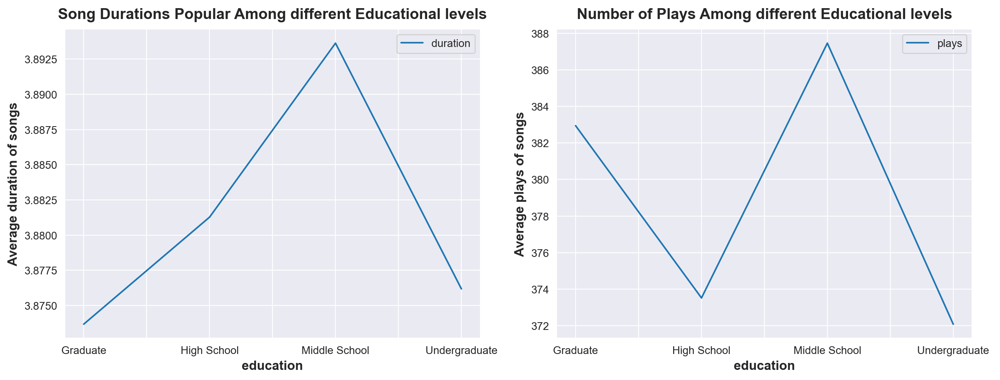

In [36]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 5))
grouped_stats1[["duration"]].plot(ax=ax1)
ax1.set(
    ylabel="Average duration of songs",
    title="Song Durations Popular Among different Educational levels",
)

grouped_stats1[["plays"]].plot(ax=ax2)
ax2.set(
    ylabel="Average plays of songs",
    title="Number of Plays Among different Educational levels",
)
plt.show() # plots the average plays and duration by education

In [37]:
df.select_dtypes(include="number").columns.tolist()

['user_id',
 'age',
 'plays',
 'artiste_popularity',
 'audio_popularity',
 'music_acousticness',
 'danceability',
 'energy',
 'key',
 'loudness',
 'mode',
 'speechiness',
 'instrumentalness',
 'liveness',
 'valence',
 'tempo',
 'time_signature',
 'duration',
 'followers',
 'scaled_ratings']

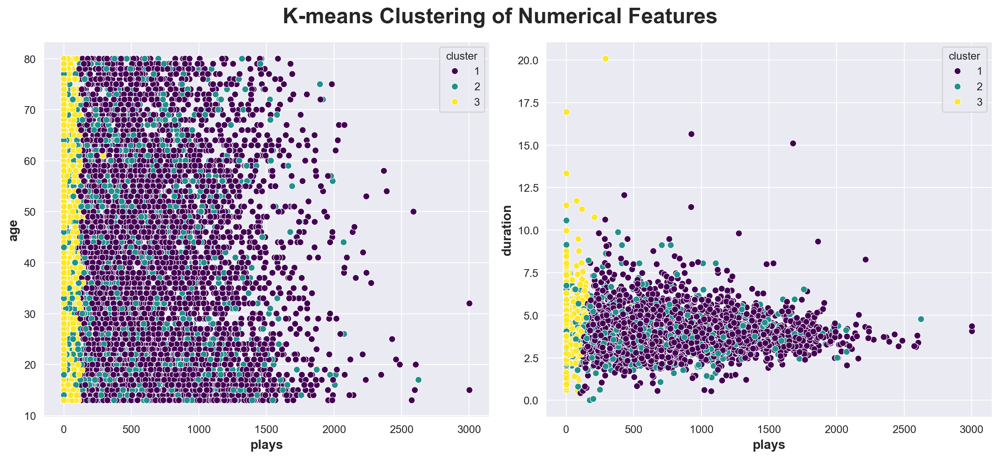

In [38]:
def create_clusters(df_: pd.DataFrame):
    df = df_.copy()
    numerical_features = df.select_dtypes(include="number").columns.tolist()
    # Standardize the features
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(df[numerical_features])

    # Apply K-means clustering
    kmeans = KMeans(n_clusters=3, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)

    # Add the cluster labels to the original DataFrame
    df["cluster"] = clusters + 1

    # Visualize the clusters
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 6))
    sns.scatterplot(
        x="plays", y="age", hue="cluster", data=df, palette="viridis", ax=ax1
    )
    sns.scatterplot(
        x="plays", y="duration", hue="cluster", data=df, palette="viridis", ax=ax2
    )
    plt.suptitle("K-means Clustering of Numerical Features", **supt_presets)
    plt.show()


create_clusters(df)

## Analysis of Song Names

---


In [39]:
from wordcloud import WordCloud
from collections import Counter
import nltk
from nltk.corpus import stopwords
import string

df_ = read_data("data/cleaned_data.csv")
# Text Preprocessing
nltk.download("stopwords")
stop_words = set(stopwords.words("english"))

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jnopa\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [40]:
def preprocess_text(text):
    # Remove punctuation
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Convert to lowercase
    text = text.lower()
    # Remove stopwords
    text = " ".join(word for word in text.split() if word not in stop_words)
    return text


df_["cleaned_music"] = df_["music"].apply(preprocess_text)

# Word Frequency Analysis
all_words = " ".join(df_["cleaned_music"]).split()
word_freq = Counter(all_words)

In [41]:
display(df_["cleaned_music"].head(20))

0                                          bank account
1     mo money mo problems feat mase puff daddy 2014...
2                                           new friends
3                      love without tragedy mother mary
4                                                 roses
                            ...                        
15                                             man year
16                                    dont happen twice
17                                 ibetchu original mix
18                                         bank account
19                                               batter
Name: cleaned_music, Length: 20, dtype: object

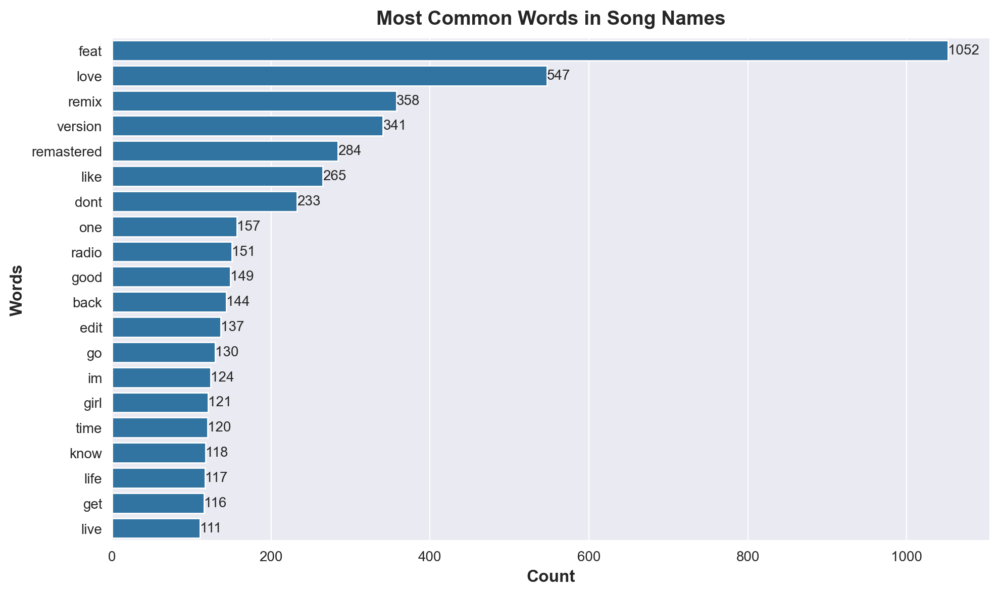

In [42]:
most_common_words = word_freq.most_common(20)

# Plotting Most Common Words
words, counts = zip(*most_common_words)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(words), ax=ax)
plt.title("Most Common Words in Song Names")
plt.xlabel("Count")
plt.ylabel("Words")
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.show()

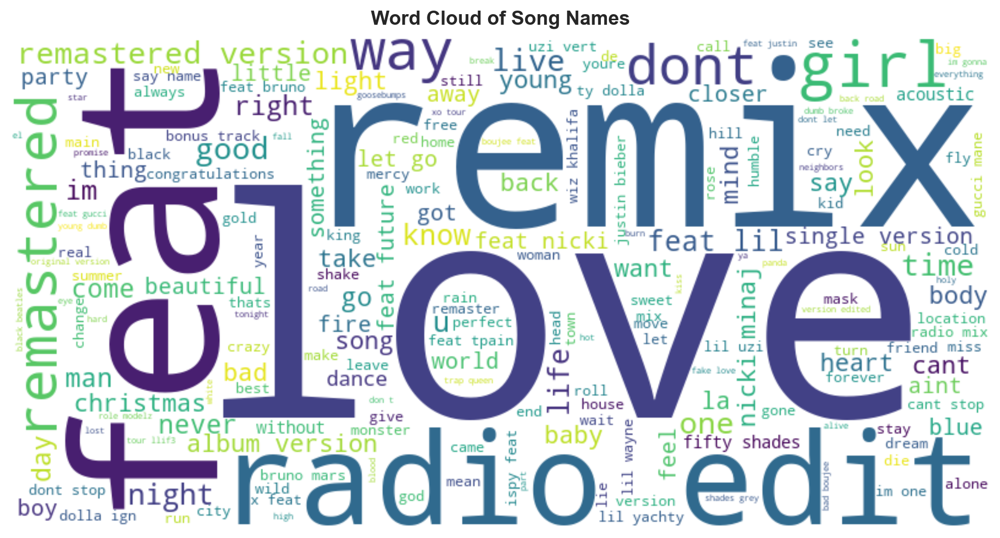

In [43]:
# Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(
    " ".join(all_words)
)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("Word Cloud of Song Names")
plt.show()

## N-Gram Analysis

---


In [44]:
from nltk.util import ngrams


def get_ngrams(text, n):
    n_grams = ngrams(text.split(), n)
    return [" ".join(grams) for grams in n_grams]


df_["bigrams"] = df_["cleaned_music"].apply(lambda x: get_ngrams(x, 2))
bigram_list = [item for sublist in df_["bigrams"].tolist() for item in sublist]
bigram_freq = Counter(bigram_list)
most_common_bigrams = bigram_freq.most_common(20)

display(most_common_bigrams)

[('radio edit', 123),
 ('remastered version', 89),
 ('feat lil', 71),
 ('album version', 49),
 ('love feat', 44),
 ('nicki minaj', 44),
 ('single version', 41),
 ('let go', 41),
 ('feat nicki', 39),
 ('remastered 2011', 37),
 ('feat future', 37),
 ('fifty shades', 32),
 ('lil yachty', 31),
 ('ty dolla', 30),
 ('dolla ign', 30),
 ('bonus track', 27),
 ('2015 remastered', 26),
 ('lil wayne', 26),
 ('dont stop', 25),
 ('say name', 25)]

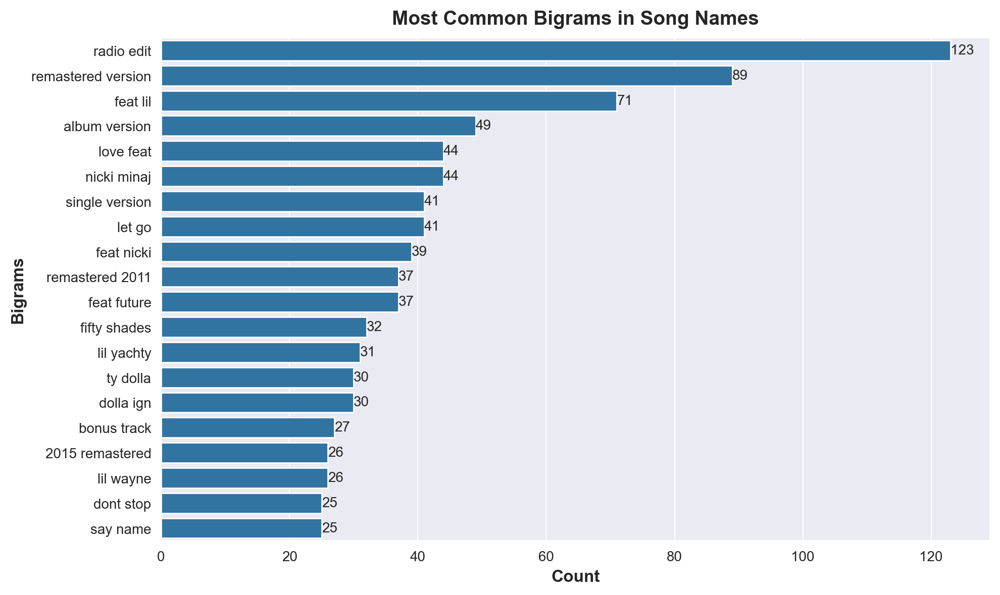

In [45]:
bigrams, counts = zip(*most_common_bigrams)
fig, ax = plt.subplots(figsize=(10, 6))
sns.barplot(x=list(counts), y=list(bigrams), ax=ax)
for container in ax.containers:
    ax.bar_label(container, fmt="%.0f")
plt.title("Most Common Bigrams in Song Names")
plt.xlabel("Count")
plt.ylabel("Bigrams")
plt.show()

In [46]:
# Check for inconsistencies in 'age'
print(df["age"].unique())

# Assuming age should be between 10 and 100
df = df[(df["age"] >= 13) & (df["age"] <= 80)]

# Check for inconsistencies in 'country'
print(df["country"].unique())
# If necessary, standardize country names or handle special cases

# Verify and correct any other inconsistencies
# For instance, check if 'duration' is reasonablea
print(df["duration"].describe())
# Assuming duration should be between 0 and 20 minutes
df = df[(df["duration"] > 0) & (df["duration"] <= 20)]

[16 44 18 60 15 35 57 17 62 14 34 50 37 78 19 55 61 64 63 77 20 74 38 25
 41 80 49 32 31 13 52 68 27 29 51 76 58 66 39 24 22 21 70 45 46 43 36 59
 26 47 28 23 40 65 56 33 79 69 53 48 54 30 67 73 42 72 71 75]
[' Urban ' ' Non-Urban ']
count    14025.000000
mean         3.880570
std          0.929399
min          0.000000
25%          3.360000
50%          3.750000
75%          4.240000
max         20.080000
Name: duration, dtype: float64


In [47]:
# from pandas_profiling import ProfileReport

# df_ = pd.read_csv("../data/cleaned_data.csv")
# profile = ProfileReport(df_, title="Pandas Profiling Report")

# profile.to_notebook_iframe()

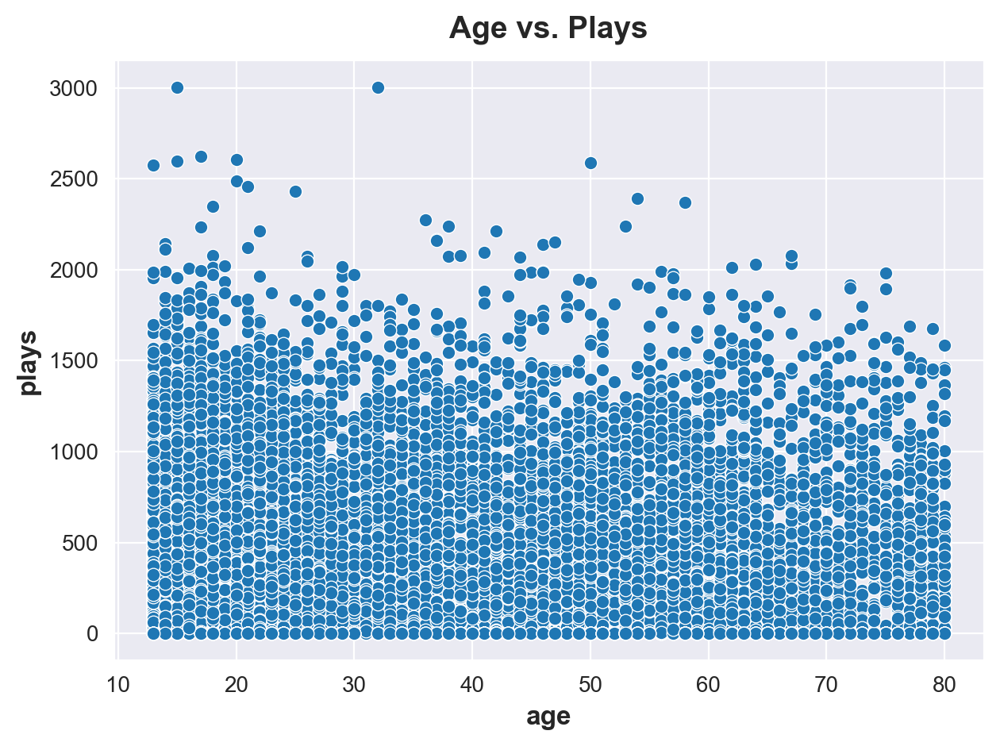

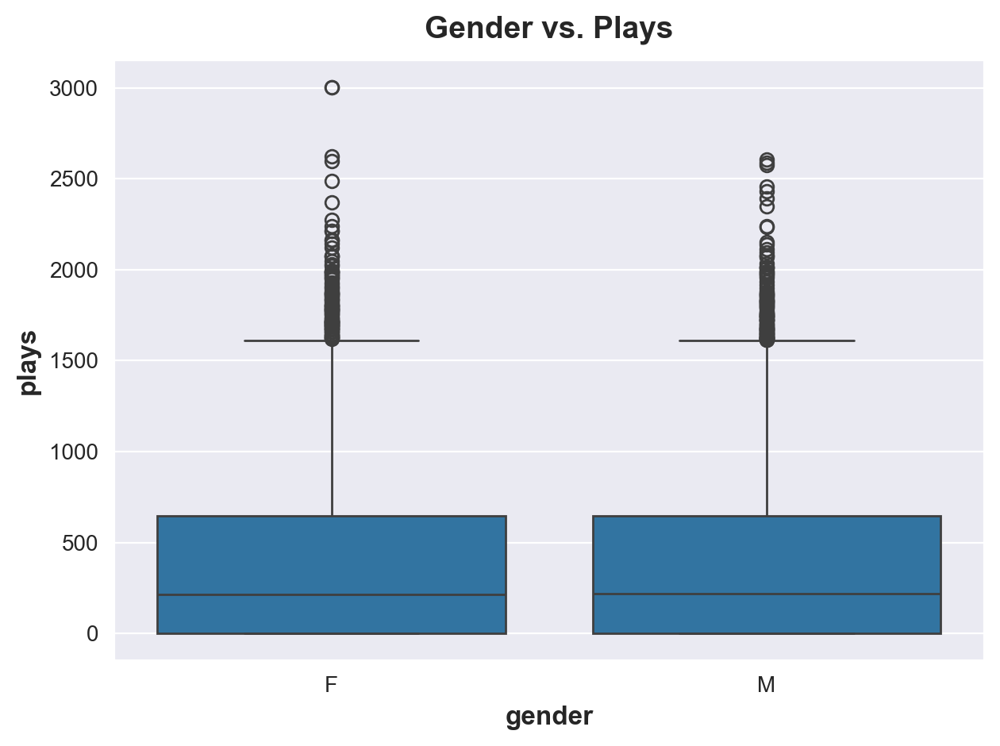

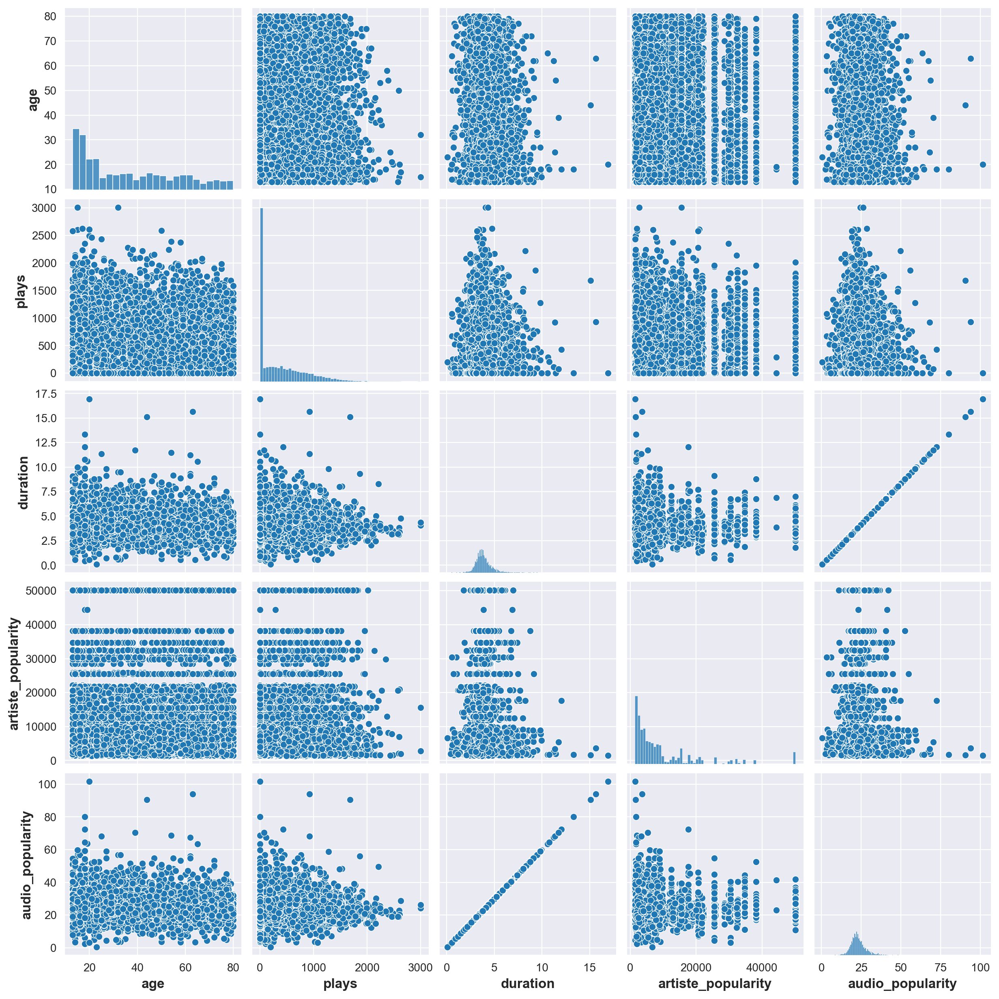

In [48]:
# Scatter plot of age vs. plays
sns.scatterplot(x="age", y="plays", data=df)
plt.title("Age vs. Plays")
plt.show()

# Box plot of gender vs. plays
sns.boxplot(x="gender", y="plays", data=df)
plt.title("Gender vs. Plays")
plt.show()

# Pair plot of key features
sns.pairplot(df[["age", "plays", "duration", "artiste_popularity", "audio_popularity"]])
plt.show()

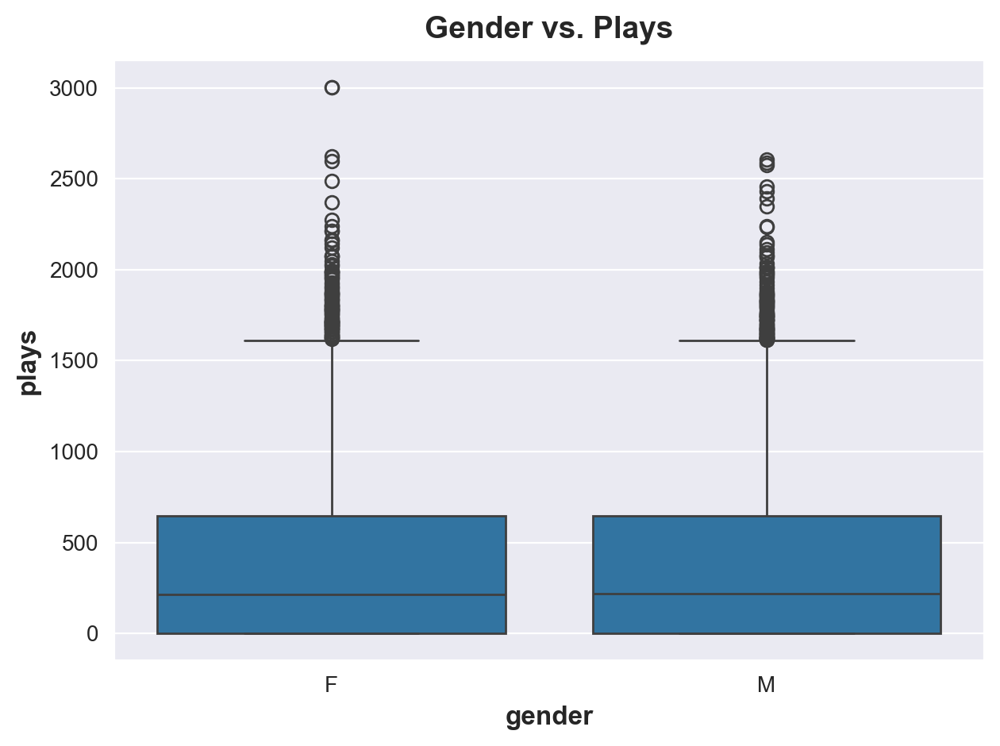

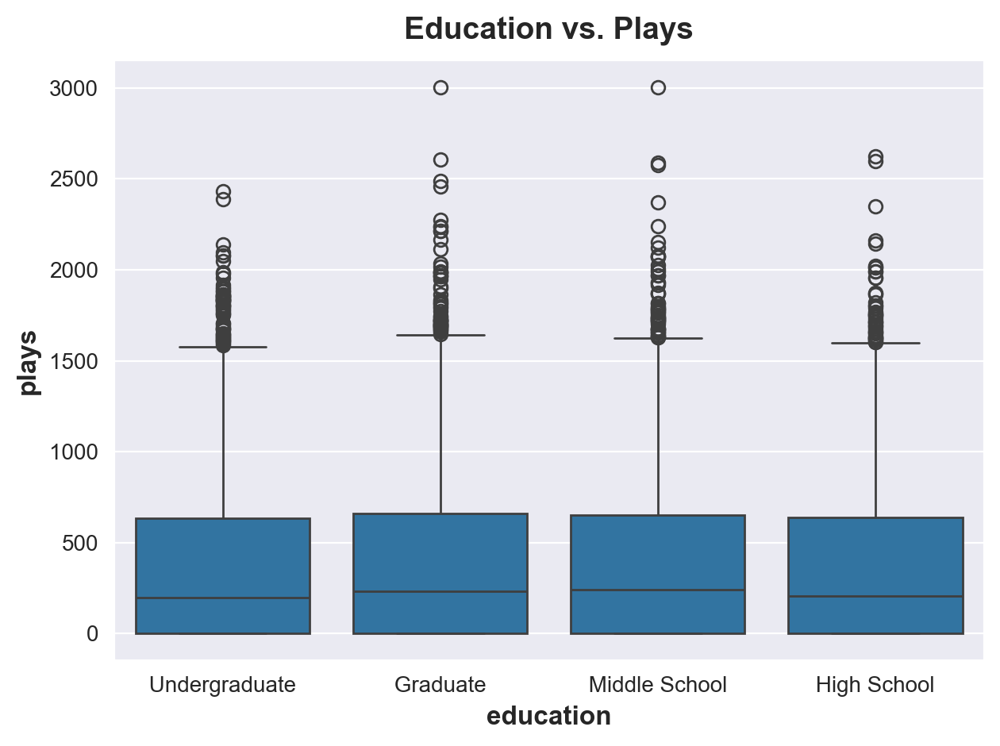

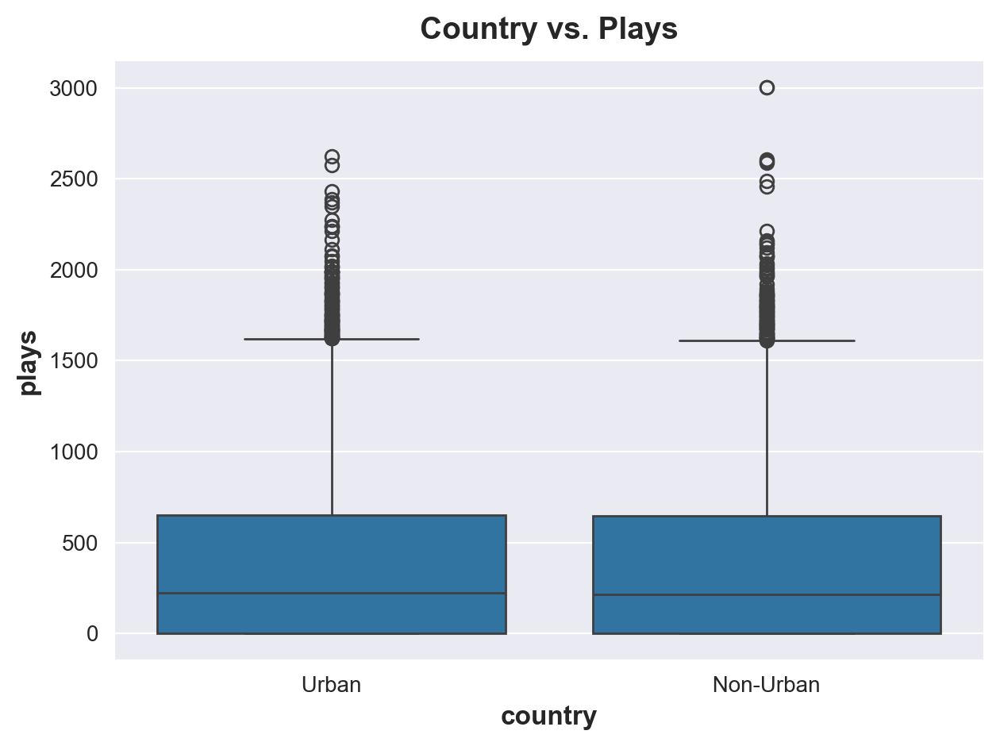

In [49]:
# Influence of demographic variables on music preferences
sns.boxplot(x="gender", y="plays", data=df)
plt.title("Gender vs. Plays")
plt.show()

sns.boxplot(x="education", y="plays", data=df)
plt.title("Education vs. Plays")
plt.show()

sns.boxplot(x="country", y="plays", data=df)
plt.title("Country vs. Plays")
plt.show()

In [50]:
# Select numeric columns only
df_numeric = df.select_dtypes(include=[np.number])

# Identify outliers using IQR method
Q1 = df_numeric.quantile(0.25)
Q3 = df_numeric.quantile(0.75)
IQR = Q3 - Q1

# Define outlier criteria
outliers = (df_numeric < (Q1 - 1.5 * IQR)) | (df_numeric > (Q3 + 1.5 * IQR))
print(outliers.sum())

# Remove outliers
df_no_outliers = df_numeric[
    ~((df_numeric < (Q1 - 1.5 * IQR)) | (df_numeric > (Q3 + 1.5 * IQR))).any(axis=1)
]

user_id                  0
age                      0
plays                  210
artiste_popularity    1118
audio_popularity       720
                      ... 
tempo                    0
time_signature           0
duration               718
followers                0
scaled_ratings           0
Length: 20, dtype: int64


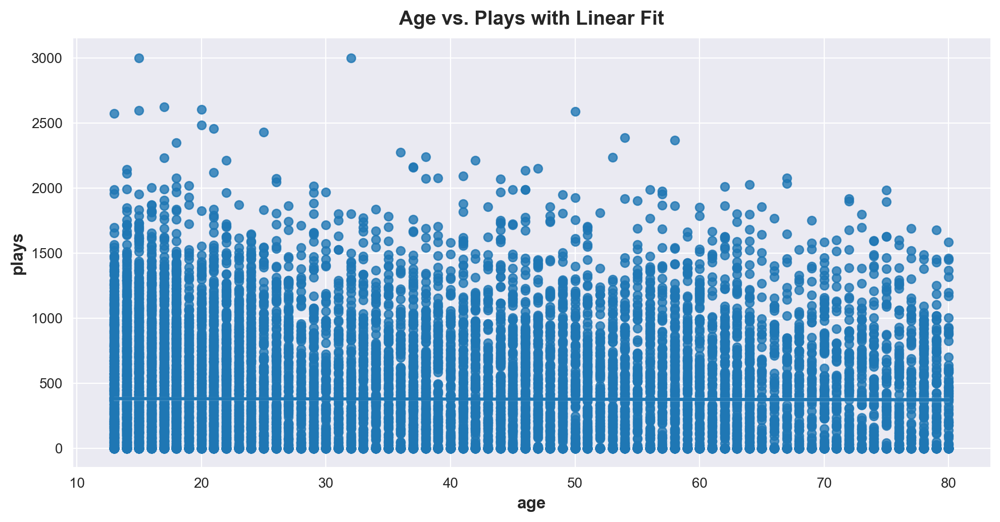

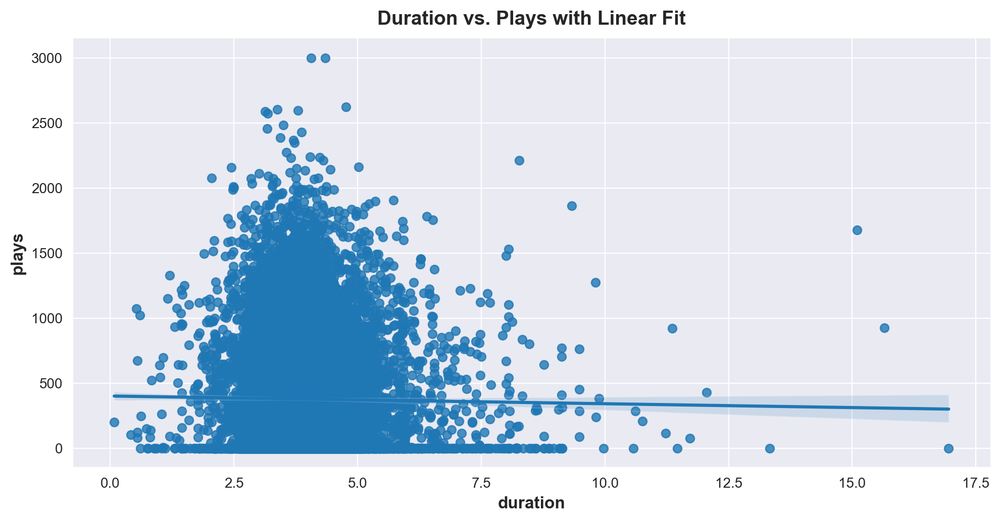

In [51]:
# Deeper analysis of relationships identified during visualization
# Example: Age and Plays
sns.lmplot(x="age", y="plays", data=df, aspect=2)
plt.title("Age vs. Plays with Linear Fit")
plt.show()

# Example: Duration and Plays
sns.lmplot(x="duration", y="plays", data=df, aspect=2)
plt.title("Duration vs. Plays with Linear Fit")
plt.show()

The two scatter plots you've generated provide some useful insights into the relationships between age, duration, and the number of plays in your dataset.

Image 1: Age vs. Plays with Linear Fit
This scatter plot shows the relationship between age and the number of plays. The data points are quite scattered, but there appears to be a general downward trend, suggesting that as age increases, the number of plays tends to decrease. However, the linear fit line indicates a relatively weak negative correlation, as there is still a lot of variability in the data points around the line.

Image 2: Duration vs. Plays with Linear Fit
This scatter plot shows the relationship between duration and the number of plays. Here, we can see a more distinct pattern. The data points form a somewhat triangular shape, with a dense cluster of points at the lower end of the duration range, and then a gradually decreasing number of points as the duration increases. The linear fit line suggests a positive correlation between duration and the number of plays, but the relationship appears to be non-linear, with the number of plays increasing more rapidly for shorter durations and then plateauing or increasing more slowly for longer durations.

Next steps:

1. Assess the strength and significance of the correlations: Calculate correlation coefficients (e.g., Pearson's r) and their associated p-values to determine the strength and statistical significance of the relationships between age, duration, and the number of plays.

2. Explore non-linear relationships: Since the scatter plot for duration vs. plays suggests a non-linear relationship, you might consider fitting a non-linear model (e.g., polynomial regression, logarithmic regression) to better capture the pattern in the data.

3. Investigate other potential predictors: Examine the relationships between the number of plays and other variables in your dataset, as there might be additional factors influencing the number of plays.

4. Perform regression analysis: Once you've identified the most relevant predictors, you can build a multiple regression model to quantify the impact of each predictor on the number of plays, while controlling for the other variables.

5. Validate and refine the model: Split your data into training and test sets, evaluate the performance of your model on the test set, and consider techniques like cross-validation and regularization to improve the model's generalization and prevent overfitting.

6. Interpret and communicate findings: Summarize the key insights from your analysis, including the strength and direction of the relationships between the predictors and the number of plays, and discuss the practical implications of your findings.


In [52]:
def wrangle(filepath: str):
    date_cols = [col for col in df.columns if "date" in col]
    PATH = os.getcwd()
    df = pd.read_csv(os.path.join(PATH, filepath))

    # convert columns to date format
    date_cols = [col for col in df.columns if "date" in col]
    for col in date_cols:
        df[col] = pd.to_datetime(df[col], errors="coerce").dropna(axis=0)
    # drop columns with high multicollineaarity
    df.drop(["audio_popularity", "scaled_ratings"], axis=1, inplace=True)
    # clean artist names
    clean_artist_name = lambda name: re.sub(r"[$]", "S", name)

    df["artist_name"] = df["artist_name"].apply(clean_artist_name)

    # drop non-relevant columns
    df.drop(["music_id", "id_artists"], axis=1, inplace=True)

    return df